In [20]:
%matplotlib inline 
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import copy
import glob
import pickle
import cv2
import numpy as np

#FIRSTLY IMPLEMENTING DETECTIONA AGAIN

In [21]:
def visualize_images(input_images):
    fig=plt.figure(figsize=(150,75))
    for i in range(len(input_images)):
        fig.add_subplot(1, len(input_images), i+1)
        plt.imshow(input_images[i])
    plt.show()

In [22]:
images_files=sorted(glob.glob("tracking_course/data/*.png"))
images=[]

index=782  #Just for demo
for img in images_files[index:index+2]:
    images.append(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))

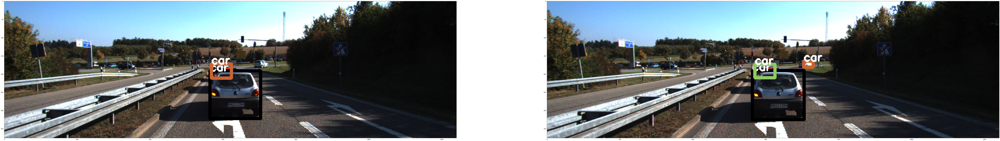

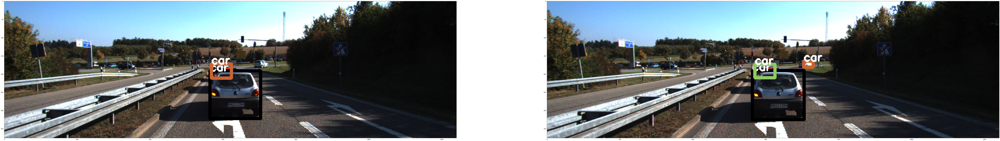

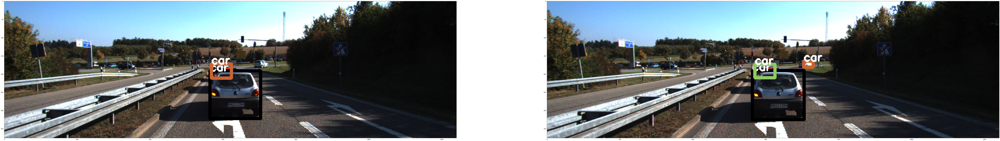

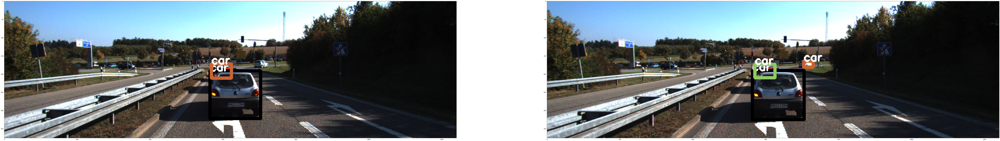

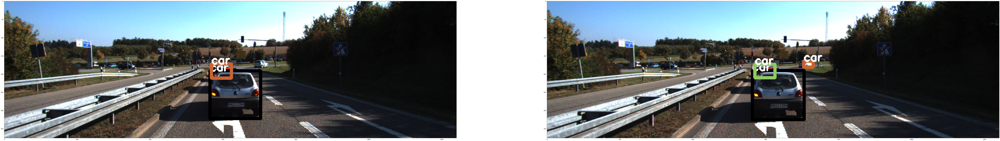

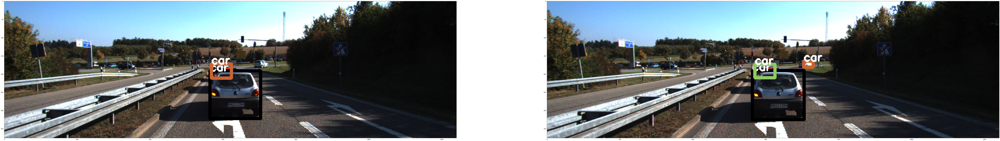

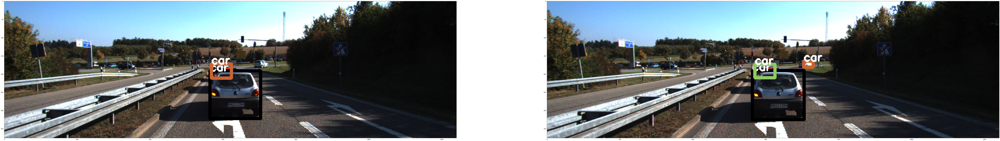

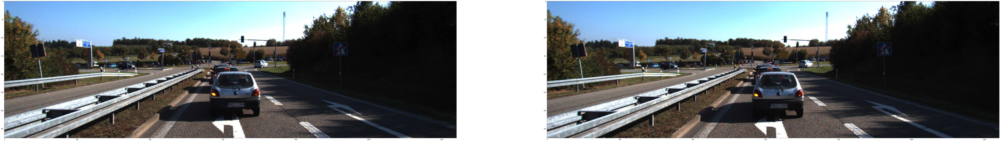

In [23]:
visualize_images(images)

In [24]:
import yolov5
model=yolov5.load("tracking_course/yolov5s.pt")

YOLOv5  2025-1-22 Python-3.8.20 torch-2.4.1+cpu CPU

Fusing layers... 
YOLOv5s summary: 283 layers, 7276605 parameters, 0 gradients
Adding AutoShape... 


##SETTING UP THE PARAMETERS

In [25]:
model.conf=0.5
model.iou=0.4

In [26]:
classesFile="tracking_course/coco.names"
with open(classesFile,'rt') as f:
    classes=f.read().rstrip('\n').split('\n')

def id_to_color(idx):
    blue=idx*5%256
    green=idx*10%256
    red=idx*20%256
    return (red,green,blue)

def draw_boxes(image,boxes,categories,not_mode=False):
    h,w,_=image.shape
    for i,box in enumerate(boxes):
        label=classes[int(categories[i])]
        color=id_to_color(i*10) if not_mode==True else (255,0,0)  #Use red if only track single object
        cv2.rectangle(image,(int(box[0]),int(box[1])),(int(box[2]),int(box[3])),color,thickness=7)
        cv2.putText(image,str(label),(int(box[0]),int(box[1])),cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),thickness=3)
    return image

def inference(img):
    results=model(img)  #Get the results from the model
    predictions = results.pred[0] #See the prediction for first image
    boxes = predictions[:,:4].tolist() #Extract the bounding boxes coordinates
    boxes_int = [[int(v) for v in box] for box in boxes] #Convert box value to int
    scores = predictions[:,4].tolist() #Extract the confidence score
    categories = predictions[:,5].tolist() #Extract class IDs
    categories_int = [int (c) for c in categories] #Convert class IDs to int
    img_out = draw_boxes(img,boxes_int,categories_int,not_mode=True)  #Since we're doing multiple object trackingnhence not_mode=True
    return img_out,boxes_int,categories_int,scores

In [27]:
yolo_images = []
yolo_boxes = []
yolo_categories = []
yolo_scores = []
pics=copy.deepcopy(images)

for img in pics:
    result,pred_boxes,pred_categories,pred_scores=inference(img)
    yolo_images.append(result)
    yolo_boxes.append(pred_boxes)
    yolo_categories.append(pred_categories)
    yolo_scores.append(pred_scores)

c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


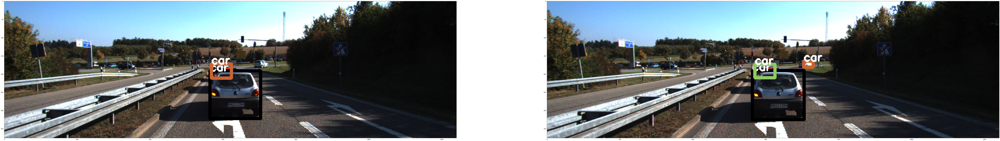

In [28]:
visualize_images(yolo_images)

In [29]:
print("Frame 1")
print("Boxes:",yolo_boxes[0])
print("Categories:",yolo_categories[0])
print("Scores:",yolo_scores[0])
print("Frame 2")
print("Boxes:",yolo_boxes[1])
print("Categories:",yolo_categories[1])
print("Scores:",yolo_scores[1])


Frame 1
Boxes: [[564, 191, 703, 322], [568, 172, 623, 211]]
Categories: [2, 2]
Scores: [0.8735786080360413, 0.6014838218688965]
Frame 2
Boxes: [[563, 190, 705, 325], [704, 164, 730, 181], [570, 173, 625, 210]]
Categories: [2, 2, 2]
Scores: [0.866899311542511, 0.6037427186965942, 0.5635864734649658]


#IMPLEMENTING HUNGARIAN ALGORITHM

In [30]:
def box_iou(box1,box2,w=1280,h=360):
    #We're not using cartesian coordinates,y axis goes down as we go up
    xA=max(box1[0],box2[0]) #Left side
    yA=max(box1[1],box2[1]) #Upper side
    xB=min(box1[2],box2[2]) #Right side
    yB=min(box1[3],box2[3]) #Lower side 

    inter_area=max(0,xB-xA+1)*max(0,yB-yA+1)
    box1_area=(box1[2]-box1[0]+1)*(box1[3]-box1[1]+1)
    box2_area=(box2[2]-box2[0]+1)*(box2[3]-box2[1]+1)
    union_area=(box1_area+box2_area)-inter_area

    iou=inter_area/float(union_area)
    return iou

In [31]:
def check_division_by_0(value,epsilon=0.01):
    if value<epsilon:
        value=epsilon
    return value

THE COST METRICS ARE IMPLEMENTED FROM  https://arxiv.org/pdf/1709.03572.pdf (formulas page 10 and 11)

In [32]:
def sanchez_matilla(box1,box2,w=1280,h=360):
    Q_dist = sqrt(pow(w,2)+pow(h,2))
    Q_shape=w*h
    distance_term = Q_dist/check_division_by_0(sqrt(pow(box1[0]-box2[0],2)+pow(box1[1]-box2[1],2)))
    shape_term=Q_shape/check_division_by_0(sqrt(pow(box1[2]-box2[2],2)+pow(box1[3]-box2[3],2)))
    linear_cost=distance_term*shape_term
    return linear_cost

In [33]:
from math import sqrt,exp

def yu(box1,box2):
    w1=0.5
    w2=1.5
    a=(box1[0]-box2[0])/check_division_by_0(box1[2])
    a_2=pow(a,2)
    b=(box1[1]-box2[1])/check_division_by_0(box1[3])
    b_2=pow(b,2)
    ab=(a_2+b_2)*w1*(-1)
    c=abs(box1[3]-box2[3])/check_division_by_0(box1[3]+box2[3])
    d=abs(box1[2]-box2[2])/check_division_by_0(box1[2]+box2[2])
    cd=(c+d)*w2*(-1)
    exponential_cost=exp(ab)*exp(cd)
    return exponential_cost

In [34]:
def convert_boxes(boxes):
    output_boxes=[]
    # print("Boxes is",boxes)
    for box in boxes:
        x1,y1,x2,y2=box
        width=x2-x1
        height=y2-y1
        centre_x=int((x1+x2)/2)
        centre_y=int((y1+y2)/2)
        output_boxes.append([centre_x,centre_y,width,height])
    return output_boxes
    

In [35]:
def total_cost(old_box,new_box,iou_thresh=0.3,linear_thresh=10000,exp_thresh=0.5):
    iou_score=box_iou(old_box,new_box)
    boxes=[old_box,new_box]
    old_box,new_box=convert_boxes(boxes)
    linear_cost=sanchez_matilla(old_box,new_box)
    expo_cost=yu(old_box,new_box)
    # print("The io_score is ",iou_score)
    # print("The linear cost is ",linear_cost)
    # print("The Expo cost is ",expo_cost)
    if(iou_score>=iou_thresh and linear_cost>=linear_thresh and expo_cost>=exp_thresh):
      return iou_score
    else:
      return 0

NOW WE DO THE ASSOCIATION:-Match old boxes with new ones

In [36]:
from scipy.optimize import linear_sum_assignment

def associate(old_boxes,new_boxes): #return matches,unmatched_detections(new ones that weren't before),unmatched_trackers(old ones that are no longer there)
    if(len(old_boxes)==0 and len(new_boxes)==0):
        return [],[],[]
    elif(len(old_boxes)==0):
        return [],new_boxes,[]
    elif(len(new_boxes)==0):
        return [],[],old_boxes
    
    iou_matrix=np.zeros((len(old_boxes),len(new_boxes)),dtype=np.float32)  #This will store the iou values of each box to each
    for i,old_box in enumerate(old_boxes):
        for j,new_box in enumerate(new_boxes):
            iou_matrix[i,j]=total_cost(old_box,new_box)
    hungarian_row,hungarian_col=linear_sum_assignment(-iou_matrix) #'-' since we need to maximize the iou
    hungarian_matrix=np.array(list(zip(hungarian_row,hungarian_col))) #Compress them together

    matches,unmatched_detections,unmatched_trackers=[],[],[]

    for h in hungarian_matrix:
        if(iou_matrix[h[0],h[1]]<0.3):
            unmatched_trackers.append(old_boxes[h[0]])
            unmatched_detections.append(new_boxes[h[1]])
        else:
            matches.append(h.reshape(1,2))
    if(len(matches)==0):
        matches=np.empty((0,2),dtype=int)
    else:
        matches=np.concatenate(matches,axis=0)

    for t,trk in enumerate(old_boxes):
        if(t not in hungarian_matrix[:,0]):
            unmatched_trackers.append(trk)
    
    for d,det in enumerate(new_boxes):
        if(d not in hungarian_matrix[:,1]):
            unmatched_detections.append(det)
    
    return matches,unmatched_detections,unmatched_trackers

In [37]:
print(yolo_boxes[0])
print(yolo_boxes[1])

[[564, 191, 703, 322], [568, 172, 623, 211]]
[[563, 190, 705, 325], [704, 164, 730, 181], [570, 173, 625, 210]]


In [38]:
matches, unmatched_detections, unmatched_trackers = associate(yolo_boxes[0], yolo_boxes[1])

In [39]:
print("Old Boxes:",yolo_boxes[0])
print("New Boxes:",yolo_boxes[1])
print("Matches:",matches) #0 of old match with 0 of new,1 of old match with 2 of new
print("Unmatched Detections:",unmatched_detections)
print("Unmatched Trackers:",unmatched_trackers)

Old Boxes: [[564, 191, 703, 322], [568, 172, 623, 211]]
New Boxes: [[563, 190, 705, 325], [704, 164, 730, 181], [570, 173, 625, 210]]
Matches: [[0 0]
 [1 2]]
Unmatched Detections: [[704, 164, 730, 181]]
Unmatched Trackers: []


#NOW APPLYING THIS IN LOOP
#THERE ARE TWO IMPLEMENTATIONS 
1. Where we keep tracking object giving it an id,and associating them frame to frame,and deallocating the id when it's not detected in new frame
2. Improved the tracking by only deallocating the id when the object hasn't been detected for "MAX_UMATCHED_AGE" of frames

In [83]:
# class Obstacle():  #Similar to an item/car/etc
#     def __init__(self,idx,box):
#         self.idx=idx
#         self.box=box

In [84]:
# def main(input_image):
#     global stored_obstacles
#     global idx

#     # 1 — Run Obstacle Detection & Convert the Boxes
#     final_image=copy.deepcopy(input_image)
#     h,w,_=final_image.shape
#     _,out_boxes,_,_ = inference(input_image)
#     #print("----> New Detections: ", out_boxes)

#     # Define the list we'll return:
#     new_obstacles=[]

#     old_obstacles=[obs.box for obs in stored_obstacles]
#     # print("The old obstacles are",old_obstacles)
#     # print("The out_boxes are ",out_boxes)
#     matches, unmatched_detections, unmatched_tracks = associate(old_obstacles, out_boxes)
#     # print("The matches are",matches)
#     # Matching
#     for match in matches:
#       obs=Obstacle(stored_obstacles[match[0]].idx,out_boxes[match[1]])
#       new_obstacles.append(obs)
#       # print("Obstacle ", obs.idx, " with box: ", obs.box, "has been matched with obstacle ", stored_obstacles[match[0]].box, "and now has age: ", obs.age)

#     # New (Unmatched) Detections
#     for new_obs in unmatched_detections:
#       obs=Obstacle(idx,new_obs)
#       new_obstacles.append(obs)
#       idx+=1
#       # print("Obstacle ", obs.idx, " has been detected for the first time: ", obs.box)

#     # Unmatched Tracking: NO RE-IDENTIFICATION FOR NOW

#     # Draw the Boxes
#     for i,obs in enumerate(new_obstacles):
#       left,top,right,bottom=obs.box
#       cv2.rectangle(final_image,(left,top),(right,bottom),id_to_color(obs.idx*10),thickness=7)
#       final_image=cv2.putText(final_image,str(obs.idx),(left-10,top-10),cv2.FONT_HERSHEY_SIMPLEX,1,id_to_color(obs.idx*10))

#     stored_obstacles=new_obstacles
#     return final_image, stored_obstacles

In [85]:
# fig=plt.figure(figsize=(100,100))
# out_imgs=[]
# idx=0
# stored_obstacles=[]

# for i in range(len(images)):
#     print("ITERATION",i)
#     out_img,stored_obstacles=main(images[i])
#     out_imgs.append(out_img)
#     fig.add_subplot(1,len(images),i+1)
#     plt.imshow(out_imgs[i])
# plt.show()

In [86]:
# ### Call the main loop

# idx = 0
# fig=plt.figure(figsize=(100,100))
# images_2 = copy.deepcopy(images)
# out_imgs = []
# stored_obstacles = []

# for i in range(len(images_2) - 5):
#     out_img, stored_obstacles = main_2(images_2[i])
#     out_imgs.append(out_img)
#     fig.add_subplot(1, len(images_2), i+1)
#     plt.imshow(out_imgs[i])

# plt.show()

In [40]:
MIN_HIT_STREAK=1
MAX_UNMATCHED_AGE=2

In [41]:
class Obstacle():
    def __init__(self,idx,box,age=1,unmatched_age=0):
        self.idx=idx   #Unique identifier
        self.box=box    #Bounding box
        self.age=age    #How many frames it has been detected
        self.unmatched_age=unmatched_age #How many frames it has been unmatched

In [42]:
def main(input_image):
    global stored_obstacles
    global idx

    final_image=copy.deepcopy(input_image)
    h,w,_=final_image.shape
    _,out_boxes,_,_ = inference(input_image)
    new_obstacles=[]
    old_obstacles=[obs.box for obs in stored_obstacles]
    matches,unmatched_detections,unmatched_tracks = associate(old_obstacles, out_boxes)

    for match in matches:
        obs=Obstacle(stored_obstacles[match[0]].idx,out_boxes[match[1]])
        new_obstacles.append(obs)

    for new_obs in unmatched_detections:
        obs=Obstacle(idx,new_obs)
        new_obstacles.append(obs)
        idx+=1

    for old_track in unmatched_tracks:
        i=old_obstacles.index(old_track)
        if i is not None:
            obs=stored_obstacles[i]
            obs.unmatched_age+=1
            new_obstacles.append(obs)

    for i,obs in enumerate(new_obstacles):
        if obs.unmatched_age>MAX_UNMATCHED_AGE:
            new_obstacles.remove(obs)
        
        if obs.age>=MIN_HIT_STREAK:
            left,top,right,bottom=obs.box
            cv2.rectangle(final_image, (left, top), (right, bottom), id_to_color(obs.idx*10), thickness=7)
            final_image = cv2.putText(final_image, str(obs.idx),(left - 10,top - 10),cv2.FONT_HERSHEY_SIMPLEX, 1,id_to_color(obs.idx*10),thickness=4)
    stored_obstacles = new_obstacles
    return final_image,stored_obstacles

In [43]:
images=[]
index=100

for img in images_files[index:index+10]:
    images.append(cv2.cvtColor(cv2.imread(img),cv2.COLOR_BGR2RGB))

c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
c:\Users\Saransh\miniconda3\

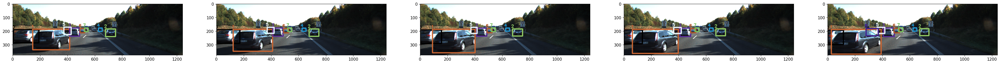

In [44]:
idx = 0
fig=plt.figure(figsize=(100,100))
images_2 = copy.deepcopy(images)
out_imgs = []
stored_obstacles = []

for i in range(len(images_2) - 5):
    out_img, stored_obstacles = main(images_2[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(images_2), i+1)
    plt.imshow(out_imgs[i])

plt.show()

In [92]:
import glob
from tqdm import tqdm

video_images = sorted(glob.glob("tracking_course/data/*.png"))
result_video = []
idx = 0
stored_obstacles = []

for img in tqdm(video_images):
    out_img, stored_obstacles = main(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))
    result_video.append(out_img)

  0%|          | 0/837 [00:00<?, ?it/s]c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
  0%|          | 1/837 [00:00<01:28,  9.44it/s]c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
  0%|          | 3/837 [00:00<01:20, 10.34it/s]c:\Users\Saransh\miniconda3\envs\allInOne\lib\site-packages\yolov5\models\common.py:709: FutureWarning: `torch.cuda.amp.autocast(args...)`

In [93]:
out = cv2.VideoWriter('out_hungarian_good.mp4',cv2.VideoWriter_fourcc(*'MP4V'), 15, (out_img.shape[1],out_img.shape[0]))

for img in result_video:
  out.write(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
out.release()